In [1]:
import cv2
from IPython import display
import PIL.Image
import numpy as np

path = './input/task2/'

%run utils.py

In [2]:
# termination criteria
criteria = (cv2.TERM_CRITERIA_EPS + cv2.TERM_CRITERIA_MAX_ITER, 30, 0.001)

########################################Blob Detector##############################################

# Setup SimpleBlobDetector parameters.
blobParams = cv2.SimpleBlobDetector_Params()

# Change thresholds
blobParams.minThreshold = 30
blobParams.maxThreshold = 255

# Filter by Area.
blobParams.filterByArea = True
#blobParams.minArea = 1364   # minArea may be adjusted to suit for your experiment
#blobParams.maxArea = 6000   # maxArea may be adjusted to suit for your experiment
blobParams.minArea = 100   # minArea may be adjusted to suit for your experiment
blobParams.maxArea = 1000000   # maxArea may be adjusted to suit for your experiment

# Filter by Circularity
blobParams.filterByCircularity = True
blobParams.minCircularity = 0.4

# Filter by Convexity
blobParams.filterByConvexity = True
blobParams.minConvexity = 0.87

# Filter by Inertia
blobParams.filterByInertia = True
blobParams.minInertiaRatio = 0.01

# Create a detector with the parameters
blobDetector = cv2.SimpleBlobDetector_create(blobParams)

In [3]:

objp = np.zeros((44, 3), np.float32)
for x in range(0, 11):
    for y in range(0, 4):
        objp[4*x+y] = (x*36, y*72 + (x%2)*36, 0)


In [4]:
objpoints = None # 3d point in real world space
imgpoints = None # 2d points in image plane.
for f in range(1,10):
#     img = cv2.imread("images/%d.jpg" % f)
    img = cv2.imread(path + "img-%02d.jpg" % f)

    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
#     keypoints = blobDetector.detect(gray)
#     im_with_keypoints = cv2.drawKeypoints(img, keypoints, np.array([]), (0,255,0), cv2.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS)
    ret, corners = cv2.findCirclesGrid(gray, (4,11),
                        flags = cv2.CALIB_CB_ASYMMETRIC_GRID + cv2.CALIB_CB_CLUSTERING,
                                     blobDetector = blobDetector)   # Find the circle grid
#     cv2_imshow(im_with_keypoints)
#     print(keypoints)
    if corners is not None and ret:
        objpoints = np.array([objp]) if objpoints is None else np.append(objpoints, [objp], axis = 0)
        imgpoints = np.array([corners]) if imgpoints is None else np.append(imgpoints, [corners], axis = 0)
    else:
        print("Skip %d.jpg" % f)


print(objpoints.shape)
print(imgpoints.shape)
(i1, i2, i3, i4) = imgpoints.shape;
imgpoints = imgpoints.reshape([i1, i2, i4])
print(imgpoints.shape)
  
ret, mtx, dist, rvecs, tvecs = cv2.calibrateCamera(objpoints, imgpoints, gray.shape[::-1], None, None)

print(mtx)
print(dist)



Skip 8.jpg
(8, 44, 3)
(8, 44, 1, 2)
(8, 44, 2)
[[3.33277286e+03 0.00000000e+00 2.04520456e+03]
 [0.00000000e+00 3.34429781e+03 1.51537554e+03]
 [0.00000000e+00 0.00000000e+00 1.00000000e+00]]
[[ 2.65951209e-01 -1.47829430e+00  1.09873495e-03 -9.85966429e-04
   2.39113956e+00]]


### It looks like after correction lines become curves. I guess camera is well calibrated in the first place or my photos are not suitable for calibration.

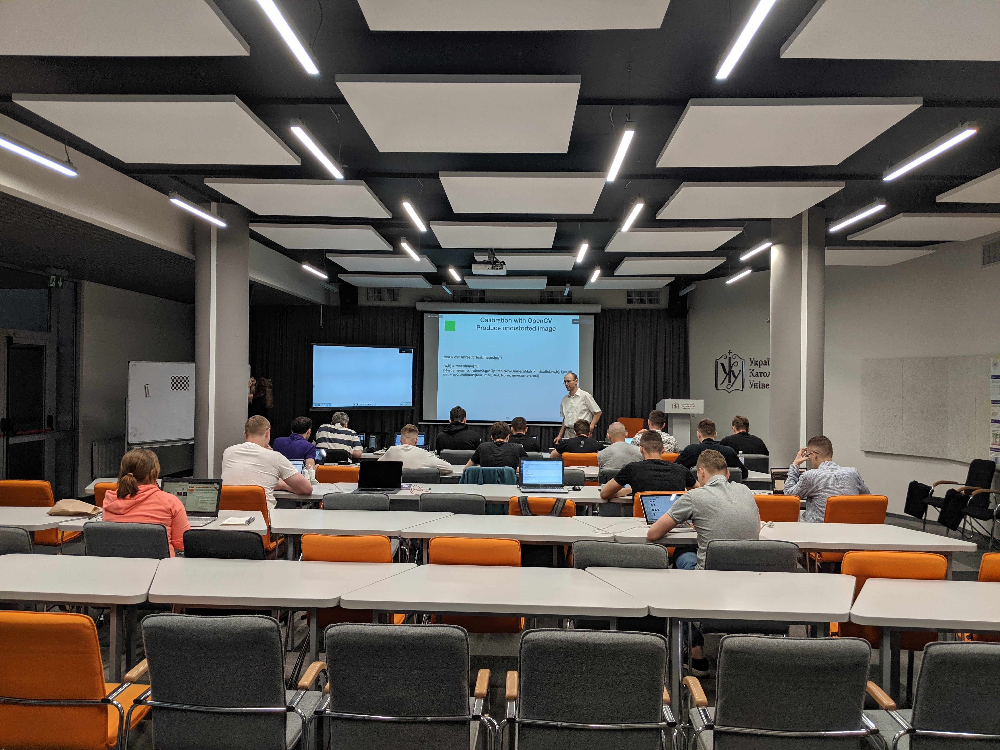

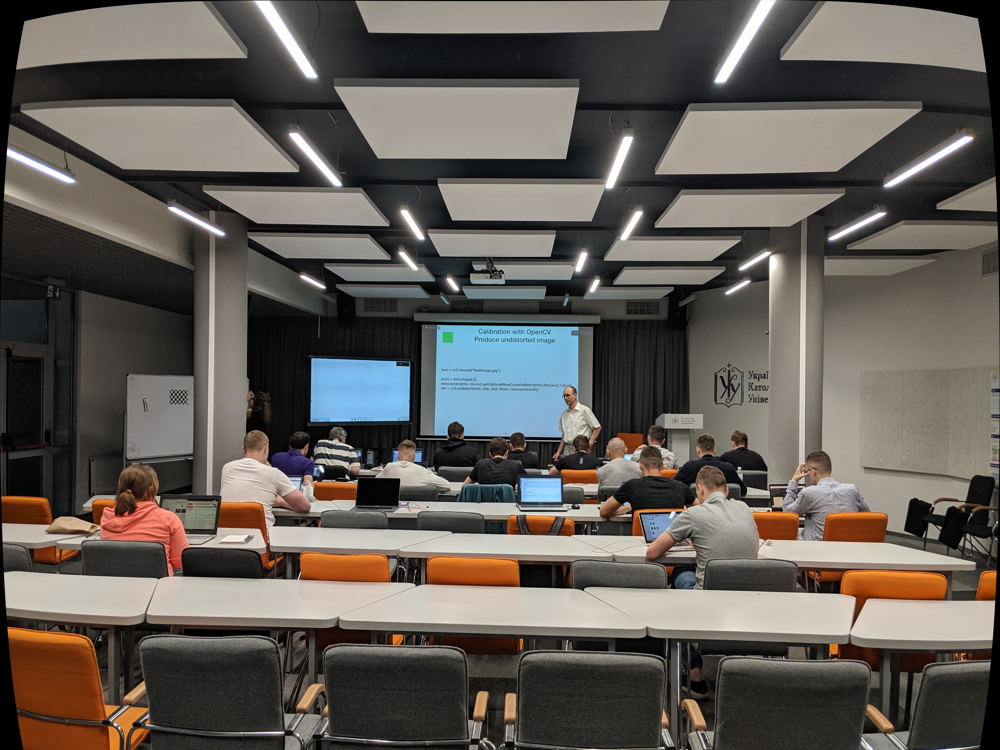

In [5]:
#dist = np.array([0,0,0,0,0])
# test = cv2.imread("./images/TestImage.jpg")
test = cv2.imread(path + "img-test.jpg")

cv2_imshow(test)

(w,h) = test.shape[:2]
newcameramtx, roi=cv2.getOptimalNewCameraMatrix(mtx,dist,(w,h),1,(w,h))
dst = cv2.undistort(test, mtx, dist, None, newcameramtx)
#mapx,mapy = cv2.initUndistortRectifyMap(mtx,dist,None,newcameramtx,(w,h),5)
#dst = cv2.remap(img,mapx,mapy,cv2.INTER_LINEAR)

# crop the image
#x,y,w,h = roi
#dst = dst[y:y+h, x:x+w]
#dst = cv2.resize(dst, (0,0), fx=0.25, fy=0.25) 
cv2_imshow(dst)

### There are distortions in the corners anter calibration. Perhaps I should have made photos with full screen object and taken smaller angels.